<a href="https://colab.research.google.com/github/skimaza/assist/blob/main/cnn_models_detectron2_assist.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# AI 전략경영MBA 경영자를 위한 딥러닝 원리의 이해
# CNN 모델 - Facebook Detectron2 예제
## Detectron2 소스 : https://github.com/facebookresearch/detectron2
## https://towardsdatascience.com/a-beginners-guide-to-object-detection-and-computer-vision-with-facebook-s-detectron2-700b6273390e 예제를 강좌에 맞춰 수정

# MS COCO dataset 을 이용하기 위한 코드 설치
MS COCO는 마이크로소프트에서 만든 객체 인식, 탐지, 세그멘테이션 데이터셋  
Common Objects in Context (https://cocodataset.org)  
객체 클래스는 80개

Colab에 기본으로 포함되지 않은 패키지는 shell command로 설치해야 함  
pip (Preferred Installer Program)  
파이썬 패키지에 포함된 기본 설치 프로그램

In [ ]:
!pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'

  Cloning https://github.com/cocodataset/cocoapi.git to /tmp/pip-req-build-a6tujfy1
  Running command git clone -q https://github.com/cocodataset/cocoapi.git /tmp/pip-req-build-a6tujfy1
  Created wheel for pycocotools: filename=pycocotools-2.0-cp37-cp37m-linux_x86_64.whl size=263924 sha256=4dc7df7203e8f0dc8588f602569adb04fa1d1fe0201e36db09cd5dc4d2dc91b1
  Stored in directory: /tmp/pip-ephem-wheel-cache-3x39cwxd/wheels/e2/6b/1d/344ac773c7495ea0b85eb228bc66daec7400a143a92d36b7b1
Successfully built pycocotools
  Attempting uninstall: pycocotools
    Found existing installation: pycocotools 2.0.2
    Uninstalling pycocotools-2.0.2:
      Successfully uninstalled pycocotools-2.0.2


## Detectron2 설치


In [ ]:
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-6qhw_s6h
  Running command git clone -q https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-6qhw_s6h
     |████████████████████████████████| 49 kB 4.4 MB/s 
     |████████████████████████████████| 74 kB 2.8 MB/s 
     |████████████████████████████████| 145 kB 39.5 MB/s 
     |████████████████████████████████| 130 kB 48.2 MB/s 
     |████████████████████████████████| 743 kB 33.9 MB/s 
     |████████████████████████████████| 747 kB 44.4 MB/s 
     |████████████████████████████████| 636 kB 64.8 MB/s 
     |████████████████████████████████| 112 kB 70.1 MB/s 
  Created wheel for detectron2: filename=detectron2-0.5-cp37-cp37m-linux_x86_64.whl size=5236617 sha256=d4db0140f51585b93cf1fdf93ce9c3dbc0d824e533f30b41df15ce30e405a0e3
  Stored in directory: /tmp/pip-ephem-wheel-cache-0bctir8p/wheels/07/dc/32/0322cb484dbefab8b9366bfedbaff5060ac7d149d69c27ca5d
  Created wheel for fvcore: filename=fvcore

# 필요한 패키지 import

In [ ]:
import numpy as np
import cv2
import random
from google.colab.patches import cv2_imshow # On your local machine you don’t need it.
import json
# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog

**from google.colab.patches import cv2_imshow**  

OpenCV의 이미지 디스플레이 함수인 cv2.imshow() 함수가 colab과 호환되지 않음.  
Google에서 cv2_imshow라는 함수를 정의해서 동일한 기능을 제공하고 있음  
(주의) '.' 대신 '_'로 연결되어 있음

# 샘플이미지 다운로드

인터넷 URL을 로컬 컴퓨터에 다운로드할 때는 wget 명령 사용  
-O 옵션으로 저장할 파일이름 지정

In [ ]:
!wget https://miro.medium.com/max/2000/1*sxjvURCdHBC0MkuZkPnIkQ.png -O street.png

--2021-10-01 03:45:37--  https://miro.medium.com/max/2000/1*sxjvURCdHBC0MkuZkPnIkQ.png
Resolving miro.medium.com (miro.medium.com)... 162.159.152.4, 162.159.153.4, 2606:4700:7::a29f:9904, ...
Connecting to miro.medium.com (miro.medium.com)|162.159.152.4|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1585392 (1.5M) [image/png]
Saving to: ‘street.png’

street.png          100%[===================>]   1.51M  --.-KB/s    in 0.02s   

2021-10-01 03:45:37 (74.2 MB/s) - ‘street.png’ saved [1585392/1585392]



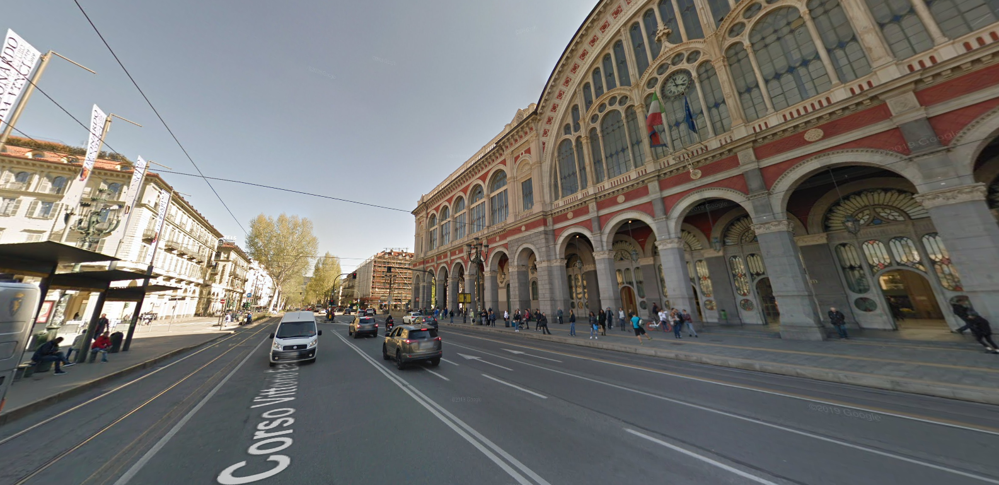

In [ ]:
im = cv2.imread('street.png')
cv2_imshow(im)

# Configuration 확인

In [ ]:
cfg = get_cfg()

In [ ]:
cfg

CfgNode({'VERSION': 2, 'MODEL': CfgNode({'LOAD_PROPOSALS': False, 'MASK_ON': False, 'KEYPOINT_ON': False, 'DEVICE': 'cuda', 'META_ARCHITECTURE': 'GeneralizedRCNN', 'WEIGHTS': '', 'PIXEL_MEAN': [103.53, 116.28, 123.675], 'PIXEL_STD': [1.0, 1.0, 1.0], 'BACKBONE': CfgNode({'NAME': 'build_resnet_backbone', 'FREEZE_AT': 2}), 'FPN': CfgNode({'IN_FEATURES': [], 'OUT_CHANNELS': 256, 'NORM': '', 'FUSE_TYPE': 'sum'}), 'PROPOSAL_GENERATOR': CfgNode({'NAME': 'RPN', 'MIN_SIZE': 0}), 'ANCHOR_GENERATOR': CfgNode({'NAME': 'DefaultAnchorGenerator', 'SIZES': [[32, 64, 128, 256, 512]], 'ASPECT_RATIOS': [[0.5, 1.0, 2.0]], 'ANGLES': [[-90, 0, 90]], 'OFFSET': 0.0}), 'RPN': CfgNode({'HEAD_NAME': 'StandardRPNHead', 'IN_FEATURES': ['res4'], 'BOUNDARY_THRESH': -1, 'IOU_THRESHOLDS': [0.3, 0.7], 'IOU_LABELS': [0, -1, 1], 'BATCH_SIZE_PER_IMAGE': 256, 'POSITIVE_FRACTION': 0.5, 'BBOX_REG_LOSS_TYPE': 'smooth_l1', 'BBOX_REG_LOSS_WEIGHT': 1.0, 'BBOX_REG_WEIGHTS': (1.0, 1.0, 1.0, 1.0), 'SMOOTH_L1_BETA': 0.0, 'LOSS_WEIGH

In [ ]:
cfg.VERSION

2

In [ ]:
cfg.merge_from_file(model_zoo.get_config_file('COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml'))

In [ ]:
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5 # set threshold for this model

In [ ]:
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url('COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml')

In [ ]:
cfg.MODEL.DEVICE

'cuda'

In [ ]:
cfg.MODEL.DEVICE

'cuda'

In [ ]:
cfg.MODEL.META_ARCHITECTURE

'GeneralizedRCNN'

# GPU 사용 여부에 따라 configuration이 달라짐
## Colab에서 GPU 할당받았는지 확인하고 configuration을 맞춰줌
## 디폴트는 DEVICE가 'gpu'로 설정되어 있음

In [ ]:
import os

def check_cpu_mode():
    if (int(os.environ["COLAB_GPU"]) > 0):
        return False
    elif ("COLAB_TPU_ADDR" in os.environ and os.environ["COLAB_TPU_ADDR"]):
        return False
    else:
        return True

In [ ]:
if check_cpu_mode():
    cfg.MODEL.DEVICE = 'cpu'

In [ ]:
predictor = DefaultPredictor(cfg)

model_final_f10217.pkl: 178MB [00:18, 9.55MB/s]                           


# predictor model의 구성 살펴보기

In [ ]:
predictor.model

GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res2): Sequential(
        (0): BottleneckBlock

In [ ]:
predictor.model.backbone

FPN(
  (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
  (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
  (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
  (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
  (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (top_block): LastLevelMaxPool()
  (bottom_up): ResNet(
    (stem): BasicStem(
      (conv1): Conv2d(
        3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
        (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
      )
    )
    (res2): Sequential(
      (0): BottleneckBlock(
        (shortcut): Conv2d(
          64, 256, kernel_size=(1, 1)

In [ ]:
predictor.model.proposal_generator

RPN(
  (rpn_head): StandardRPNHead(
    (conv): Conv2d(
      256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1)
      (activation): ReLU()
    )
    (objectness_logits): Conv2d(256, 3, kernel_size=(1, 1), stride=(1, 1))
    (anchor_deltas): Conv2d(256, 12, kernel_size=(1, 1), stride=(1, 1))
  )
  (anchor_generator): DefaultAnchorGenerator(
    (cell_anchors): BufferList()
  )
)

In [ ]:
predictor.model.roi_heads

StandardROIHeads(
  (box_pooler): ROIPooler(
    (level_poolers): ModuleList(
      (0): ROIAlign(output_size=(7, 7), spatial_scale=0.25, sampling_ratio=0, aligned=True)
      (1): ROIAlign(output_size=(7, 7), spatial_scale=0.125, sampling_ratio=0, aligned=True)
      (2): ROIAlign(output_size=(7, 7), spatial_scale=0.0625, sampling_ratio=0, aligned=True)
      (3): ROIAlign(output_size=(7, 7), spatial_scale=0.03125, sampling_ratio=0, aligned=True)
    )
  )
  (box_head): FastRCNNConvFCHead(
    (flatten): Flatten(start_dim=1, end_dim=-1)
    (fc1): Linear(in_features=12544, out_features=1024, bias=True)
    (fc_relu1): ReLU()
    (fc2): Linear(in_features=1024, out_features=1024, bias=True)
    (fc_relu2): ReLU()
  )
  (box_predictor): FastRCNNOutputLayers(
    (cls_score): Linear(in_features=1024, out_features=81, bias=True)
    (bbox_pred): Linear(in_features=1024, out_features=320, bias=True)
  )
  (mask_pooler): ROIPooler(
    (level_poolers): ModuleList(
      (0): ROIAlign(output

# 이미지의 색상 포맷
## 디폴트가 BGR임

In [ ]:
cfg.INPUT.FORMAT

'BGR'

# 이미지에서 객체 탐지

In [ ]:
outputs = predictor(im)

/usr/local/lib/python3.7/dist-packages/torch/_tensor.py:575: UserWarning: floor_divide is deprecated, and will be removed in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values.
To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor'). (Triggered internally at  /pytorch/aten/src/ATen/native/BinaryOps.cpp:467.)
  return torch.floor_divide(self, other)
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


In [ ]:
outputs.keys()

dict_keys(['instances'])

# 탐지된 객체 리스트

In [ ]:
instances = outputs['instances']

In [ ]:
len(instances)

31

In [ ]:
instances[0]

Instances(num_instances=1, image_height=769, image_width=1585, fields=[pred_boxes: Boxes(tensor([[604.7542, 511.9128, 702.5654, 584.8875]])), scores: tensor([0.9900]), pred_classes: tensor([2]), pred_masks: tensor([[[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         ...,
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False]]])])

In [ ]:
instances[0].pred_masks.shape

torch.Size([1, 769, 1585])

In [ ]:
instances[0].pred_masks.nonzero()

tensor([[  0, 513, 654],
        [  0, 513, 655],
        [  0, 513, 656],
        ...,
        [  0, 583, 635],
        [  0, 583, 636],
        [  0, 583, 637]])

In [ ]:
cv2_imshow(im[510:590, 630:660])

## pred_masks는 탐지된 객체의 픽셀

In [ ]:
instances.pred_classes, instances.pred_classes.size()

(tensor([2, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 7, 0, 0, 2, 0,
         0, 2, 3, 0, 2, 0, 0]), torch.Size([31]))

In [ ]:
instances.scores, instances.scores.size()

(tensor([0.9900, 0.9830, 0.9822, 0.9801, 0.9468, 0.9449, 0.9348, 0.9229, 0.9225,
         0.9214, 0.9106, 0.8808, 0.8657, 0.8318, 0.8233, 0.8184, 0.8021, 0.7869,
         0.7743, 0.7410, 0.7399, 0.7366, 0.7280, 0.6870, 0.6856, 0.6003, 0.5955,
         0.5909, 0.5789, 0.5781, 0.5111]), torch.Size([31]))

# 객체 클래스 확인

In [ ]:
metadata = MetadataCatalog.get(cfg.DATASETS.TRAIN[0])
metadata

Metadata(evaluator_type='coco', image_root='datasets/coco/train2017', json_file='datasets/coco/annotations/instances_train2017.json', name='coco_2017_train', thing_classes=['person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus', 'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'stop sign', 'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow', 'elephant', 'bear', 'zebra', 'giraffe', 'backpack', 'umbrella', 'handbag', 'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball', 'kite', 'baseball bat', 'baseball glove', 'skateboard', 'surfboard', 'tennis racket', 'bottle', 'wine glass', 'cup', 'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple', 'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog', 'pizza', 'donut', 'cake', 'chair', 'couch', 'potted plant', 'bed', 'dining table', 'toilet', 'tv', 'laptop', 'mouse', 'remote', 'keyboard', 'cell phone', 'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'book', 'clock', 'vase', 'scissors', 'teddy b

In [ ]:
class_catalog = metadata.thing_classes

In [ ]:
class_catalog[2]

'car'

In [ ]:
len(class_catalog)

80

In [ ]:
instances.pred_boxes, len(instances.pred_boxes)

(Boxes(tensor([[ 604.7542,  511.9128,  702.5654,  584.8875],
         [1314.3333,  485.8268, 1345.7896,  539.3832],
         [ 139.1897,  496.5554,  174.8897,  576.5550],
         [ 554.2613,  499.4727,  600.3551,  537.4614],
         [ 980.8524,  486.3490,  992.8354,  523.8195],
         [1079.6813,  489.0974, 1107.4498,  536.4631],
         [ 902.0057,  486.5292,  914.7924,  533.1278],
         [ 998.7172,  493.2116, 1031.2782,  540.3141],
         [1065.3492,  486.5768, 1084.5262,  538.5688],
         [ 611.1402,  496.7953,  626.0640,  528.8675],
         [ 799.0850,  490.3344,  808.0724,  519.8076],
         [  41.0793,  529.4919,  108.0706,  597.0471],
         [1043.0490,  487.1237, 1065.0352,  526.5150],
         [ 933.6371,  493.0849,  950.7802,  538.4984],
         [ 829.9280,  489.7773,  842.1377,  524.3108],
         [ 883.0089,  487.5822,  894.3090,  514.7499],
         [ 774.7675,  487.7835,  786.0012,  518.2080],
         [ 853.3400,  494.8409,  873.4088,  530.6900],
    

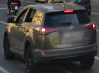

In [ ]:
cv2_imshow(im[511:584, 604:703])

# x, y, width, height

In [ ]:
instances.pred_boxes[0]

Boxes(tensor([[604.7542, 511.9128, 702.5654, 584.8875]]))

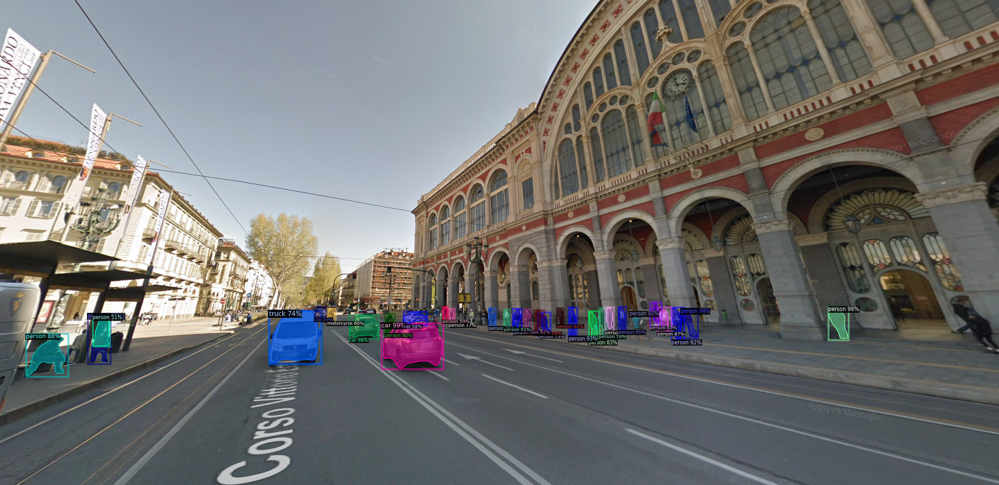

In [ ]:
v = Visualizer(im, MetadataCatalog.get(cfg.DATASETS.TRAIN[0]))
v = v.draw_instance_predictions(outputs['instances'].to('cpu'))
cv2_imshow(v.get_image())

# 다른 이미지로 테스트

https://nypost.com/wp-content/uploads/sites/2/2017/12/nyc-streets.jpg

In [ ]:
!wget https://nypost.com/wp-content/uploads/sites/2/2017/12/nyc-streets.jpg -O street2.jpg

--2021-10-01 03:46:06--  https://nypost.com/wp-content/uploads/sites/2/2017/12/nyc-streets.jpg
Resolving nypost.com (nypost.com)... 192.0.66.32
Connecting to nypost.com (nypost.com)|192.0.66.32|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 7184316 (6.9M) [image/jpeg]
Saving to: ‘street2.jpg’

street2.jpg         100%[===================>]   6.85M  39.1MB/s    in 0.2s    

2021-10-01 03:46:07 (39.1 MB/s) - ‘street2.jpg’ saved [7184316/7184316]



In [ ]:
!ls -l

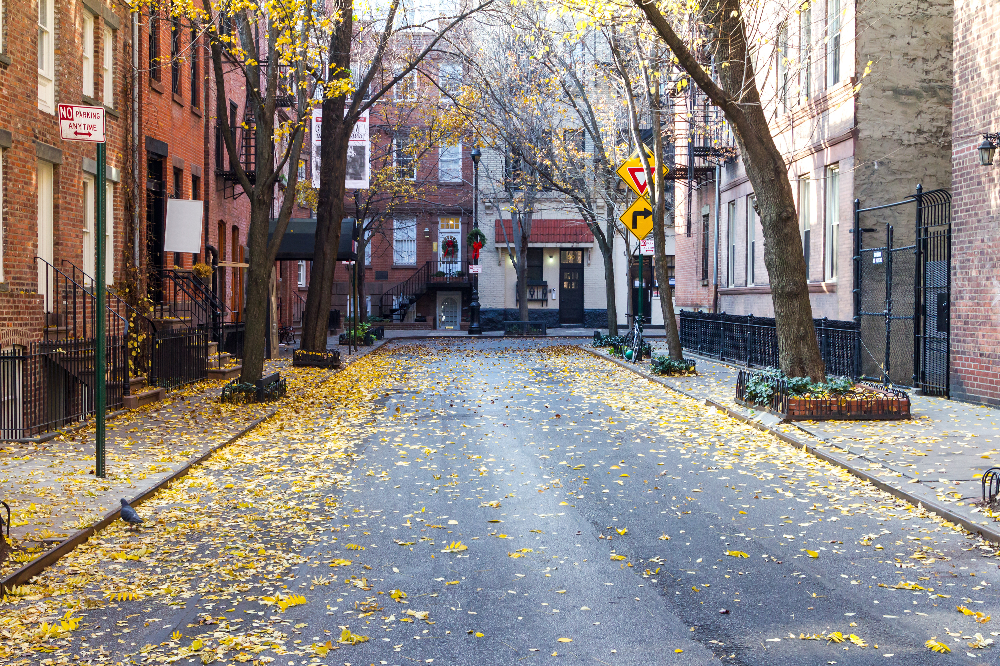

In [ ]:
im2 = cv2.imread('street2.jpg')
cv2_imshow(im2)

In [ ]:
outputs2 = predictor(im2)
instances2 = outputs2['instances']

v2 = Visualizer(im2, MetadataCatalog.get(cfg.DATASETS.TRAIN[0]))
v2 = v2.draw_instance_predictions(outputs2['instances'].to('cpu'))
cv2_imshow(v2.get_image())

https://media.timeout.com/images/102973595/750/422/image.jpg

In [ ]:
!wget https://media.timeout.com/images/102973595/750/422/image.jpg -O living_room1.jpg

--2021-10-01 03:46:20--  https://media.timeout.com/images/102973595/750/422/image.jpg
Resolving media.timeout.com (media.timeout.com)... 13.224.163.122, 13.224.163.88, 13.224.163.127, ...
Connecting to media.timeout.com (media.timeout.com)|13.224.163.122|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 56447 (55K) [image/jpeg]
Saving to: ‘living_room1.jpg’

living_room1.jpg    100%[===================>]  55.12K   305KB/s    in 0.2s    

2021-10-01 03:46:21 (305 KB/s) - ‘living_room1.jpg’ saved [56447/56447]



In [ ]:
!ls -l

total 8628
-rw-r--r-- 1 root root   56447 Feb  4  2017 living_room1.jpg
drwxr-xr-x 1 root root    4096 Sep 16 13:40 sample_data
-rw-r--r-- 1 root root 7184316 May  4  2020 street2.jpg
-rw-r--r-- 1 root root 1585392 Oct  1 03:45 street.png


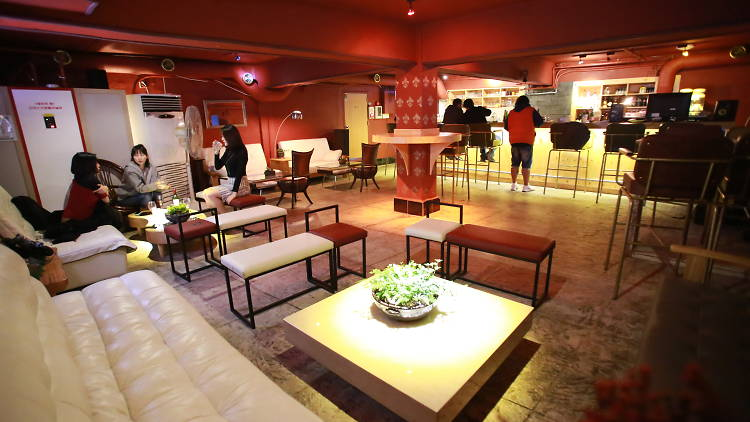

In [47]:
im2 = cv2.imread('living_room1.jpg')
cv2_imshow(im2)

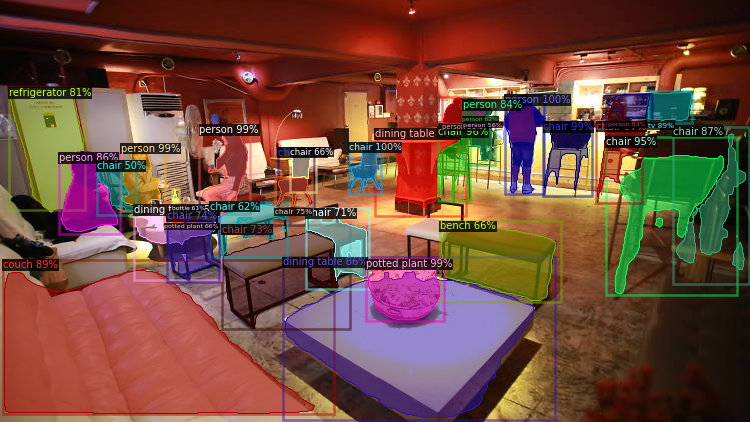

In [48]:
outputs2 = predictor(im2)
instances2 = outputs2['instances']

v2 = Visualizer(im2, MetadataCatalog.get(cfg.DATASETS.TRAIN[0]))
v2 = v2.draw_instance_predictions(outputs2['instances'].to('cpu'))
cv2_imshow(v2.get_image())

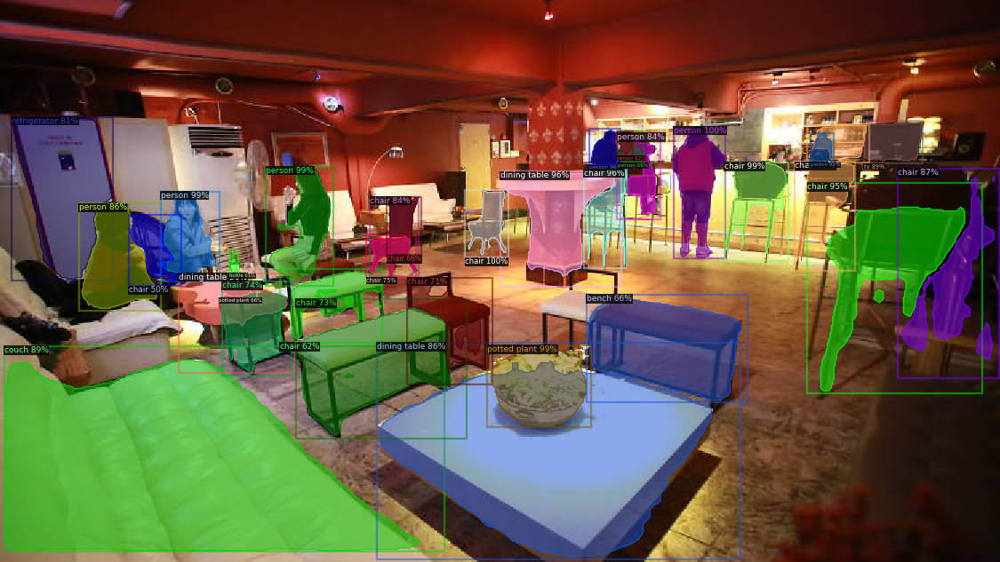

In [49]:
v2 = Visualizer(im2, MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.5)
v2 = v2.draw_instance_predictions(outputs2['instances'].to('cpu'))
cv2_imshow(v2.get_image())